In [1]:
!pip install kagglehub

In [3]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [4]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("omkargurav/face-mask-dataset")

print("Path to dataset files:", path)

100%|██████████| 163M/163M [00:04<00:00, 37.7MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/omkargurav/face-mask-dataset/versions/1


In [5]:
!pip install kaggle

In [6]:
!kaggle datasets download -d omkargurav/face-mask-dataset

Dataset URL: https://www.kaggle.com/datasets/omkargurav/face-mask-dataset
License(s): unknown
 70% 114M/163M [00:00<00:00, 1.09GB/s]
100% 163M/163M [00:00<00:00, 1.02GB/s]


In [7]:
from zipfile import ZipFile
dataset="/content/face-mask-dataset.zip"
with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print("Extracted")

Extracted


In [8]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mping
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from sklearn.model_selection import train_test_split

In [9]:
!ls

data  face-mask-dataset.zip  kaggle.json  sample_data


In [10]:
with_mask_files=os.listdir("/content/data/with_mask")
without_mask_files=os.listdir("/content/data/without_mask")


In [12]:
print(with_mask_files[0:5])
print(with_mask_files[-5:])
print(without_mask_files[0:5])
print(without_mask_files[-5:])

['with_mask_3197.jpg', 'with_mask_49.jpg', 'with_mask_3333.jpg', 'with_mask_587.jpg', 'with_mask_101.jpg']
['with_mask_1961.jpg', 'with_mask_2449.jpg', 'with_mask_3302.jpg', 'with_mask_1571.jpg', 'with_mask_1162.jpg']
['without_mask_1146.jpg', 'without_mask_216.jpg', 'without_mask_2264.jpg', 'without_mask_1369.jpg', 'without_mask_2551.jpg']
['without_mask_2244.jpg', 'without_mask_1499.jpg', 'without_mask_2156.jpg', 'without_mask_1342.jpg', 'without_mask_1497.jpg']


In [13]:
print("with mask",len(with_mask_files))
print("without mask:",len(without_mask_files))

with mask 3725
without mask: 3828


In [14]:
with_mask_labels=[1]*len(with_mask_files)
without_mask_labels=[0]*len(without_mask_files)

In [15]:
len(with_mask_labels)

3725

In [16]:
len(without_mask_labels)

3828

In [18]:
labels=with_mask_labels+without_mask_labels
len(labels)
print(labels[0:5])
print(labels[-5:])

[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


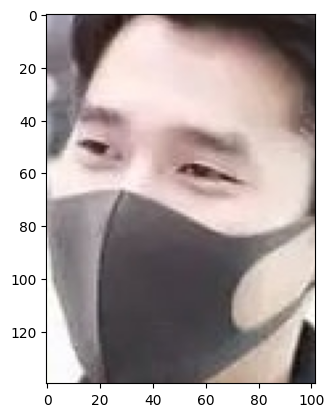

In [19]:
img=mping.imread("/content/data/with_mask/with_mask_587.jpg")
imag=plt.imshow(img)
plt.show()

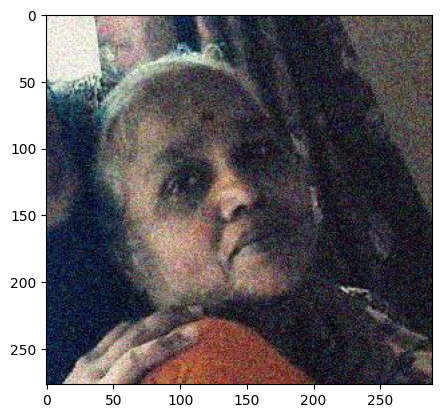

In [20]:
img=mping.imread("/content/data/without_mask/without_mask_1342.jpg")
imag=plt.imshow(img)
plt.show()

In [21]:
data=[]
with_mask_path="/content/data/with_mask/"
for img_path in with_mask_files:
  image=Image.open(with_mask_path+img_path)
  image=image.resize((128,128))
  image=image.convert("RGB")
  image=np.array(image)
  data.append(image)

without_mask_path="/content/data/without_mask/"
for img_path in without_mask_files:
  image=Image.open(without_mask_path+img_path)
  image=image.resize((128,128))
  image=image.convert("RGB")
  image=np.array(image)
  data.append(image)

/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [22]:
len(data)

7553

In [23]:
type(data)

list

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
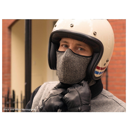

In [24]:
data[0]

In [25]:
type(data[0])

numpy.ndarray

In [26]:
data[0].shape

(128, 128, 3)

In [27]:
X=np.array(data)
y=np.array(labels)

In [28]:
type(X)
type(y)

numpy.ndarray

In [29]:
y

array([1, 1, 1, ..., 0, 0, 0])

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=4)

In [34]:
print(X.shape, X_train.shape, X_test.shape)

(7553, 128, 128, 3) (6042, 128, 128, 3) (1511, 128, 128, 3)


In [35]:
X_train_scaled=X_train/255
X_test_scaled=X_test/255

In [37]:
X_test_scaled[0]

array([[[0.16862745, 0.0745098 , 0.05882353],
        [0.15294118, 0.05882353, 0.04313725],
        [0.13333333, 0.03921569, 0.02352941],
        ...,
        [0.11764706, 0.04705882, 0.        ],
        [0.12941176, 0.05882353, 0.00784314],
        [0.1372549 , 0.06666667, 0.01176471]],

       [[0.15294118, 0.05882353, 0.04313725],
        [0.14509804, 0.05098039, 0.03529412],
        [0.12941176, 0.03529412, 0.01960784],
        ...,
        [0.10196078, 0.03137255, 0.        ],
        [0.12156863, 0.05098039, 0.00392157],
        [0.13333333, 0.0627451 , 0.00784314]],

       [[0.1372549 , 0.04313725, 0.02745098],
        [0.13333333, 0.03921569, 0.02352941],
        [0.12156863, 0.02745098, 0.01176471],
        ...,
        [0.08627451, 0.01568627, 0.        ],
        [0.10980392, 0.03921569, 0.        ],
        [0.1254902 , 0.05490196, 0.        ]],

       ...,

       [[0.73333333, 0.68235294, 0.60784314],
        [0.72941176, 0.67843137, 0.60392157],
        [0.72156863, 0

In [38]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

In [41]:
model=Sequential()
model.add(Conv2D(32, kernel_size=(3,3), activation="relu", input_shape=(128, 128, 3)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Conv2D(32, kernel_size=(3,3), activation="relu"))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Flatten())
model.add(Dense(128, activation="relu"))
model.add(Dropout(0.5))
model.add(Dense(64, activation="relu"))
model.add(Dropout(0.5))
model.add(Dense(2, activation="sigmoid"))

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [42]:
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)               │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 61, 61, 32)     │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 30, 30, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 28800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │     3,686,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,705,058 (14.13 MB)

 Trainable params: 3,705,058 (14.13 MB)

 Non-trainable params: 0 (0.00 B)

In [44]:
model.compile(
    optimizer="adam",
    loss="sparse_categorical_crossentropy",
    metrics=["accuracy"]
)

In [45]:
history=model.fit(X_train_scaled, y_train, validation_split=0.1, epochs=10)

Epoch 1/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 14s 42ms/step - accuracy: 0.6543 - loss: 0.8287 - val_accuracy: 0.8645 - val_loss: 0.3490
Epoch 2/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 11s 15ms/step - accuracy: 0.8728 - loss: 0.3252 - val_accuracy: 0.8959 - val_loss: 0.2599
Epoch 3/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.8797 - loss: 0.3127 - val_accuracy: 0.8959 - val_loss: 0.2848
Epoch 4/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - accuracy: 0.8958 - loss: 0.2420 - val_accuracy: 0.9306 - val_loss: 0.2345
Epoch 5/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.9167 - loss: 0.2067 - val_accuracy: 0.8066 - val_loss: 0.4467
Epoch 6/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.8961 - loss: 0.2565 - val_accuracy: 0.9289 - val_loss: 0.2439
Epoch 7/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - accuracy: 0.9385 - loss: 0.1504 - val_accuracy: 0.9355 - val_loss: 0.2396
Epoch 8/10
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - accuracy: 0.9493 - loss: 0.1370 - val_ac

In [48]:
loss, accuracy=model.evaluate(X_test_scaled, y_test)
print("Test Accuracy:", round(accuracy*100,2))

48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.8999 - loss: 0.3400
Test Accuracy: 90.6


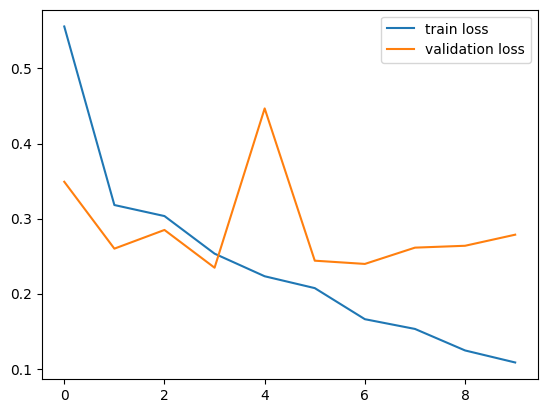

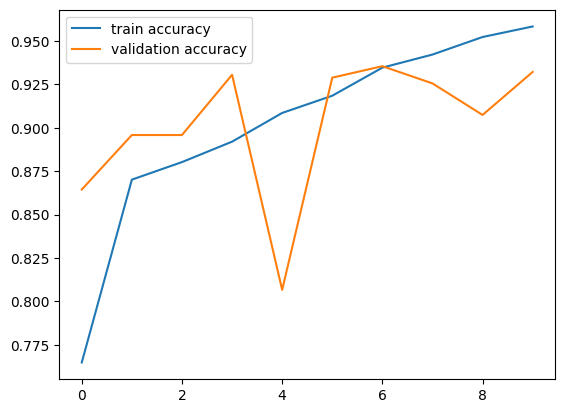

In [50]:
h = history


plt.plot(h.history['loss'], label='train loss')
plt.plot(h.history['val_loss'], label='validation loss')
plt.legend()
plt.show()


plt.plot(h.history['accuracy'], label='train accuracy')
plt.plot(h.history['val_accuracy'], label='validation accuracy')
plt.legend()
plt.show()

Path of the image to be predicted: /content/pexels-itfeelslikefilm-695954.jpg


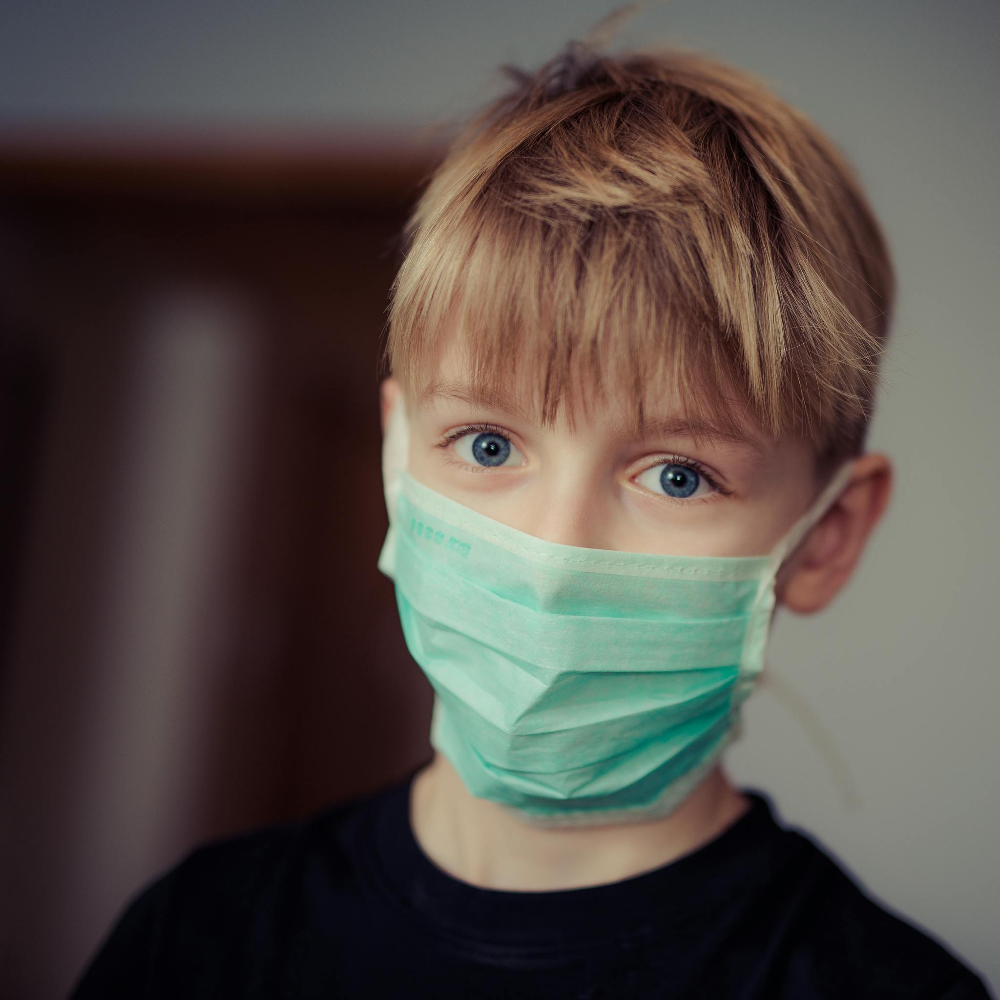

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
[[0.14409551 0.7730662 ]]
1
The person in the image is wearing a mask


In [52]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resized = cv2.resize(input_image, (128,128))

input_image_scaled = input_image_resized/255

input_image_reshaped = np.reshape(input_image_scaled, [1,128,128,3])

input_prediction = model.predict(input_image_reshaped)

print(input_prediction)


input_pred_label = np.argmax(input_prediction)

print(input_pred_label)


if input_pred_label == 1:

  print('The person in the image is wearing a mask')

else:

  print('The person in the image is not wearing a mask')

Path of the image to be predicted: /content/pexels-simon-robben-55958-614810.jpg


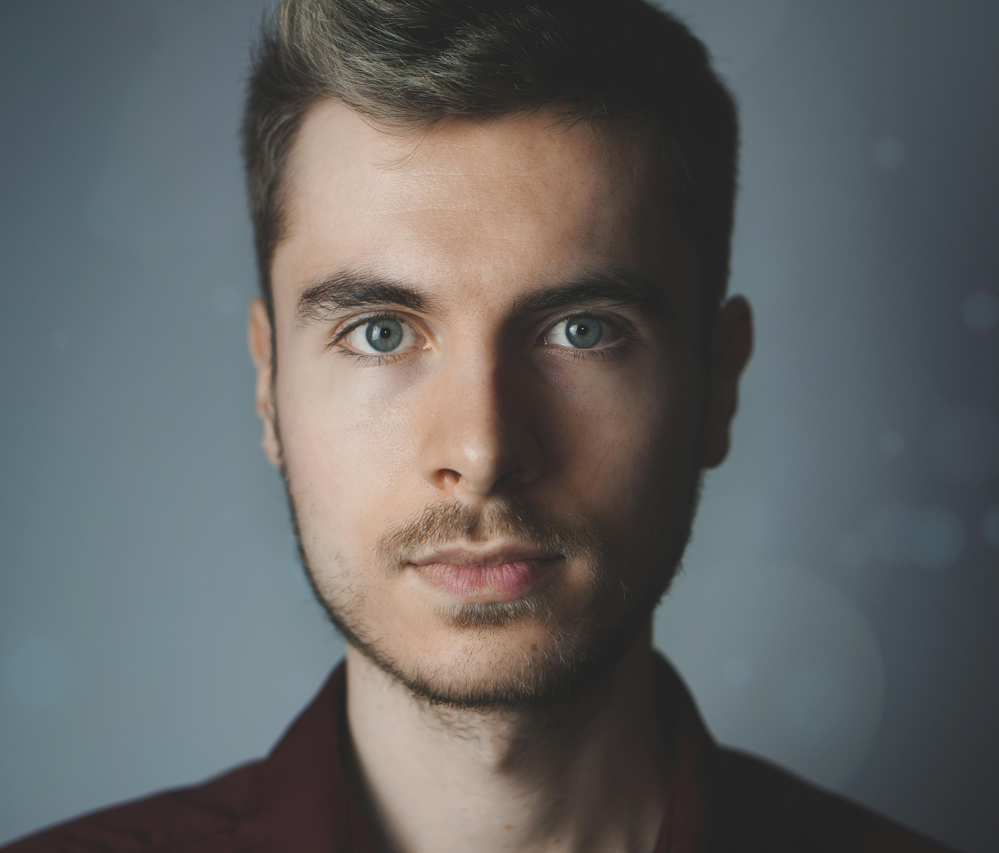

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
[[0.60678947 0.4674915 ]]
0
The person in the image is not wearing a mask


In [53]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resized = cv2.resize(input_image, (128,128))

input_image_scaled = input_image_resized/255

input_image_reshaped = np.reshape(input_image_scaled, [1,128,128,3])

input_prediction = model.predict(input_image_reshaped)

print(input_prediction)


input_pred_label = np.argmax(input_prediction)

print(input_pred_label)


if input_pred_label == 1:

  print('The person in the image is wearing a mask')

else:

  print('The person in the image is not wearing a mask')

In [54]:
model.save('face_mask_detection.h5')